In [1]:
    import matplotlib.pyplot as plt
    from scipy.io import wavfile
    import numpy as np
    from IPython.display import Audio
    import scipy.signal as sig
    import scipy.fft as fft

In [2]:
%matplotlib widget

In [3]:
def fm_modulation(
        modulating_signal: np.ndarray,
        carrier_freq: float,
        fs: float,
        mod_index: float
) -> np.ndarray:
    """
    Frequency modulation
    Parameters
    ----------
    modulating_signal: numpy.ndarray
        modulating signal
    carrier_freq: float
        carrier frequency
    fs: float
        sampling frequency
    mod_index: float
        modulation index

    Returns
    -------
    numpy.ndarray
        modulated signal
    """
    dt = 1/fs
    time = np.arange(len(modulating_signal)) * dt
    modulated_signal = np.sin(2 * np.pi * carrier_freq * time + mod_index * np.cumsum(modulating_signal)*dt)
    return modulated_signal

def am_demodulation(
        modulated_signal: np.ndarray,
) -> np.ndarray:
    """
    Amplitude demodulation
    Parameters
    ----------
    modulated_signal: numpy.ndarray
        modulated signal
    fs: float
        sampling frequency
    mod_index: float
        modulation index

    Returns
    -------
    numpy.ndarray
        demodulated signal
    """
    # use hilbert transform to get the envelope
    analytic_signal = sig.hilbert(modulated_signal)
    amplitude_envelope = np.abs(analytic_signal)
    # demodulate
    return amplitude_envelope

def fm_demodulation(
        modulated_signal: np.ndarray,
        carrier_freq: float,
        fs: float,
        mod_index: float
) -> np.ndarray:
    """
    Frequency demodulation
    Parameters
    ----------
    modulated_signal: numpy.ndarray
        modulated signal
    carrier_freq: float
        carrier frequency
    fs: float
        sampling frequency

    Returns
    -------
    numpy.ndarray
        demodulated signal
    """
    # differentiate the modulated signal and than use am demodulation to get the instantaneous phase
    dt = 1/fs
    diff_modulated_signal = np.diff(modulated_signal) / dt
    demod = am_demodulation(diff_modulated_signal)
    return demod - np.mean(demod)

# Solution

In [4]:
Audio("fm_modulated_fs_250khz_fc_80khz.wav")

In [5]:
    fs, data_mod = wavfile.read("fm_modulated_fs_250khz_fc_80khz.wav")
    fc = 80e3
    Audio(fm_demodulation(data_mod, fc, fs, 10000), rate=fs)

# make the EX

In [10]:
    # load the sound file
    fs, data = wavfile.read("piano_250khz.wav")
    data = data / np.max(np.abs(data))
    data = data - np.mean(data)
    Audio(data, rate=fs)

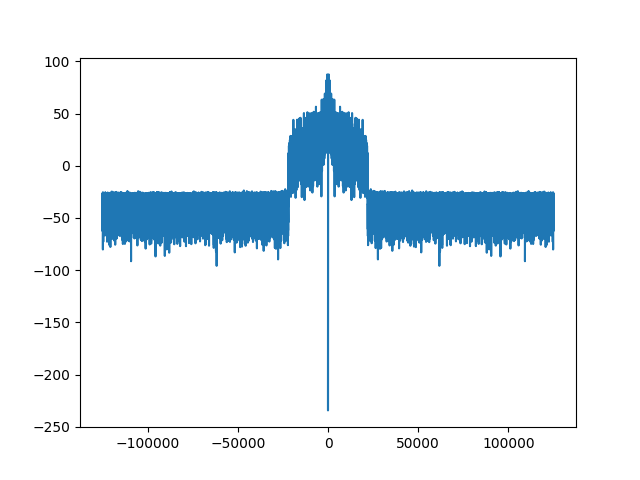

In [11]:
freq_axis = fft.fftshift(fft.fftfreq(len(data), 1/fs))
data_f = fft.fftshift(fft.fft(data))
plt.figure()
plt.plot(freq_axis, 20*np.log10(np.abs(data_f)))

In [14]:
2**15

32768

In [23]:
data_mod.min()

np.float64(-0.9999999999998229)

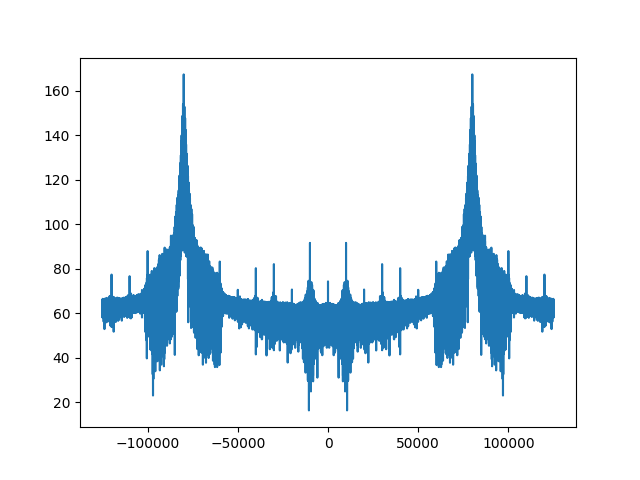

In [41]:
fc = 80e3
data_mod = fm_modulation(data,fc, fs, 20000)
data_mod = data_mod * (2**10)
data_mod = data_mod.astype(np.int16)
data_mod_f = fft.fftshift(fft.fft(data_mod))
plt.figure()
plt.plot(freq_axis, 20*np.log10(np.abs(data_mod_f)))

In [43]:
np.save("fm_modulated_fs_250khz_fc_80khz.npy", data_mod)
wavfile.write("fm_modulated_fs_250khz_fc_80khz.wav", fs, data_mod)

In [44]:
Audio("fm_modulated_fs_250khz_fc_80khz.wav")

In [42]:
Audio(fm_demodulation(data_mod, fc, fs, 10000), rate=fs)

In [6]:
K = int(4*fs)
iq_data = data[:K,0] + 1j*data[:K,1]

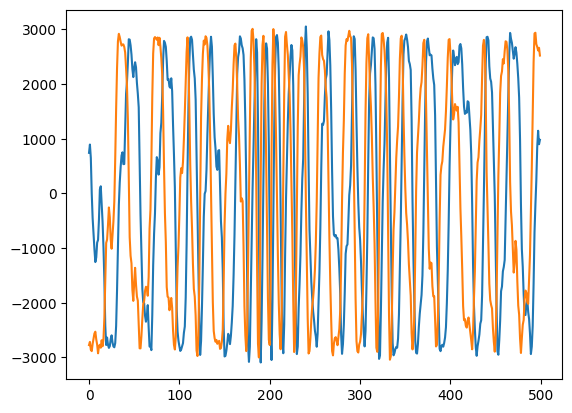

In [8]:
plt.plot(iq_data.real[:500])
plt.plot(iq_data.imag[:500])
plt.show()

In [14]:
fc = 80e3
time_axis = np.arange(len(iq_data)) / fs
iq_passband = iq_data * np.exp(2j*np.pi*fc*time_axis)
iq_air = np.real(iq_passband)

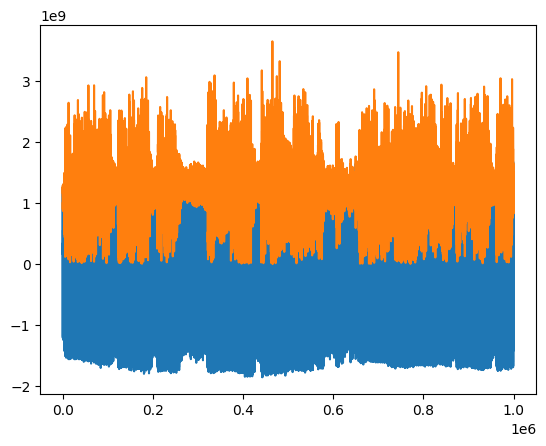

502654.8245743669


In [17]:
my_demod = fm_demodulation(iq_air, fc, fs, 1.0)
display(Audio(my_demod, rate=fs))

In [13]:
iq_demode = fm_demod(iq_data, df=1.0, fc=0.0)
display(Audio(iq_demode, rate=fs))

In [ ]:
iq_data_modulated = np.real(iq_data)

In [22]:
def fm_modulation(
        modulating_signal: np.ndarray,
        carrier_freq: float,
        fs: float,
        mod_index: float
) -> np.ndarray:
    """
    Frequency modulation
    Parameters
    ----------
    modulating_signal: numpy.ndarray
        modulating signal
    carrier_freq: float
        carrier frequency
    fs: float
        sampling frequency
    mod_index: float
        modulation index

    Returns
    -------
    numpy.ndarray
        modulated signal
    """
    dt = 1/fs
    time = np.arange(len(modulating_signal)) * dt
    modulated_signal = np.sin(2 * np.pi * carrier_freq * time + mod_index * np.cumsum(modulating_signal)*dt)
    return modulated_signal

In [26]:
fc = 80e3
modulated_signal = fm_modulation(iq_demode, fc, fs, 1.0)

In [29]:
display(Audio(fm_demod(modulated_signal,1, 2*fc/fs), rate=fs))